# LFP and Theta Extraction

## Imports


In [2]:
import datajoint as dj
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from pynwb import NWBHDF5IO

import spyglass.common as sgc
import spyglass.lfp as lfp
import spyglass.spikesorting.v1 as sgs
import spyglass.position as sgp
from spyglass.common import Nwbfile
from spyglass.utils.nwb_helper_fn import get_nwb_file

# Make sure the session exists
nwb_file_name = "IM-1478_20220726_.nwb"

# Fetch file create date and source version to make sure it's up to date
nwb_file_abspath = Nwbfile.get_abs_path(nwb_file_name)
nwbf = get_nwb_file(nwb_file_abspath)
print(f"File created on {nwbf.file_create_date[0].strftime('%m/%d/%Y %H:%M:%S')}")
print(f"Source script version {nwbf.source_script}")

/home/scrater/miniforge3/envs/spyglass/lib/python3.10/site-packages/datajoint/plugin.py:4: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  import pkg_resources
[2025-12-02 00:26:13,527][INFO]: DataJoint 0.14.6 connected to scrater@lmf-db.cin.ucsf.edu:3306
/home/scrater/miniforge3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:590: UserWarning: Ignoring the following cached namespace(s) because another version is already loaded:
ndx-franklab-novela - cached version: 0.2.0, loaded version: 0.2.3
The loaded extension(s) may not be compatible with the cached extension(s) in the file. Please check the extension documentation and ignore this warning if these versions are compatible.
  self.warn_for_ignored_namespaces(ignored_namespaces)


File created on 10/29/2025 18:00:06
Source script version jdb_to_nwb 2.1.2.dev2+g12a9b6eed.d20251030


[69.228     74.1225024]


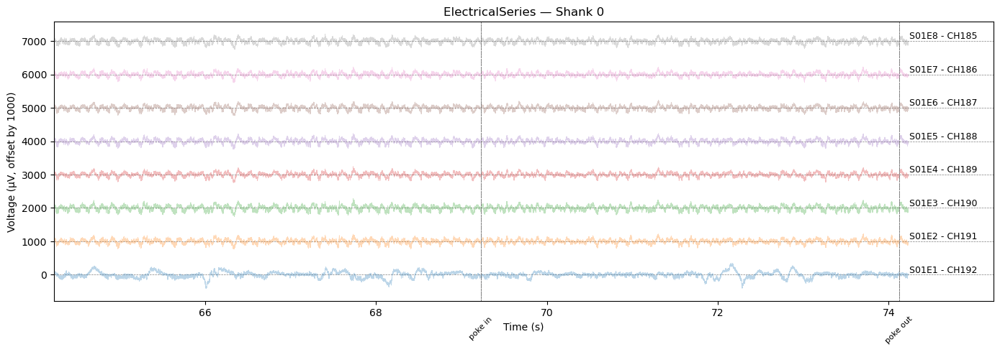

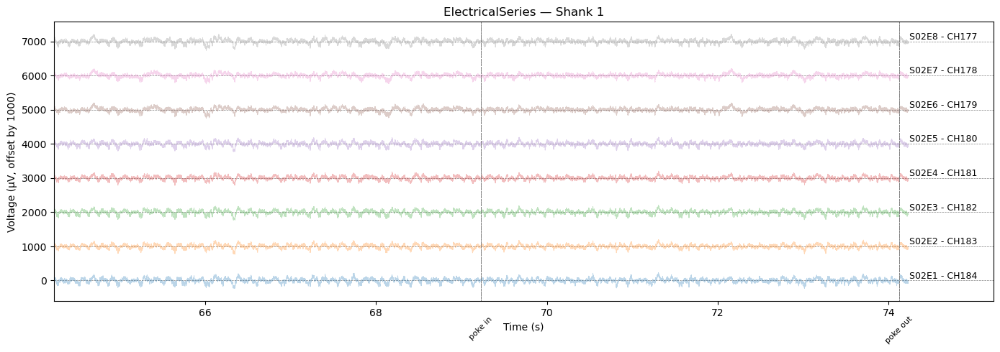

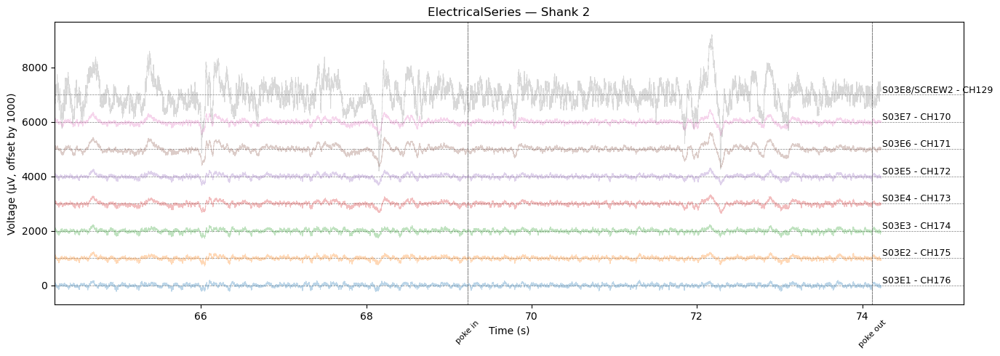

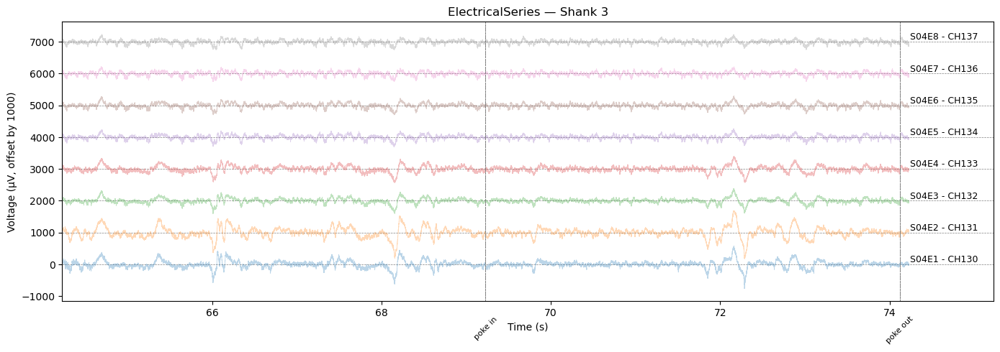

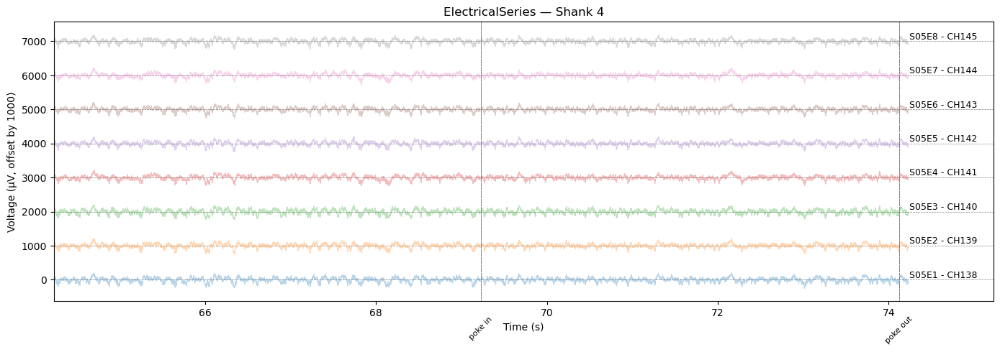

...

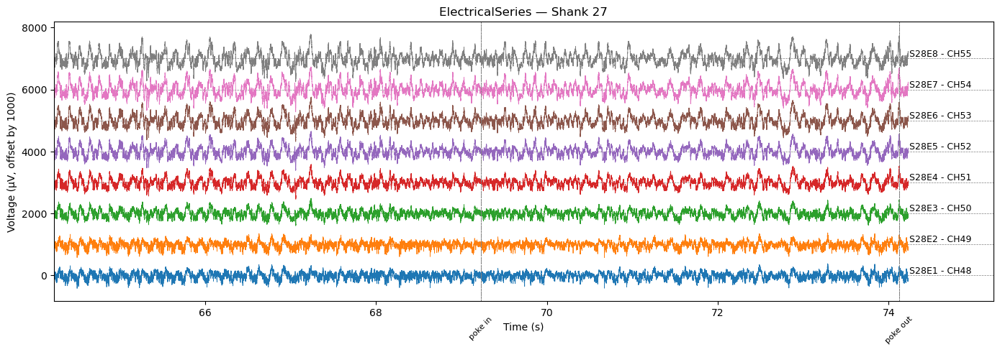

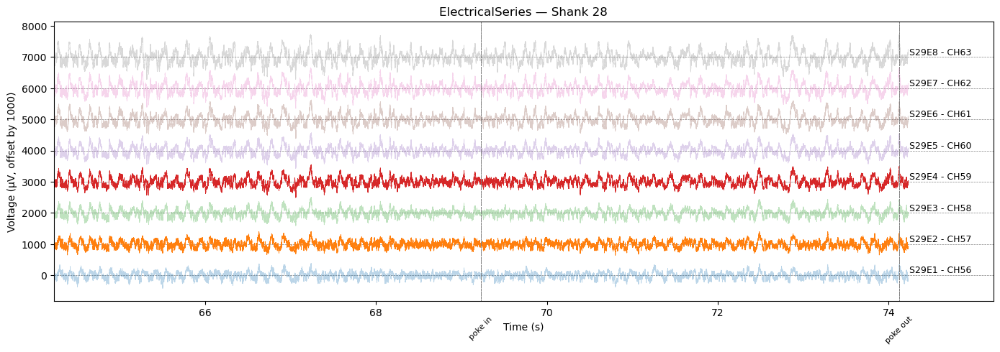

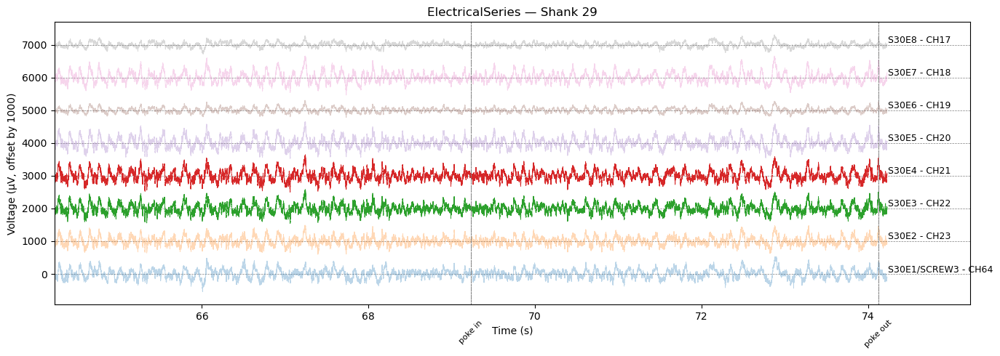

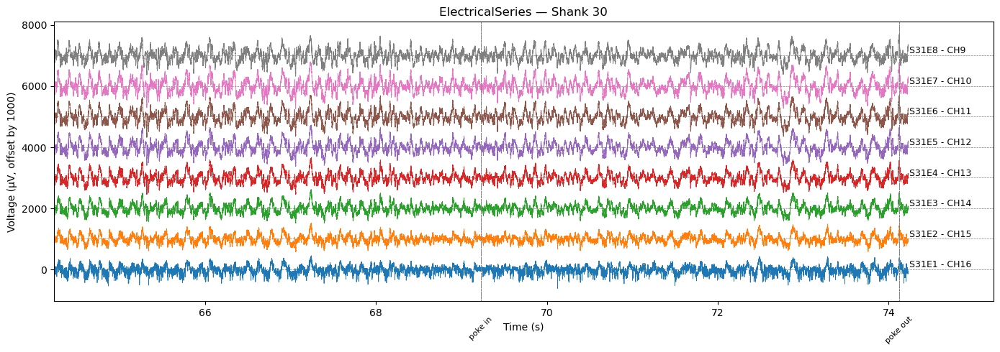

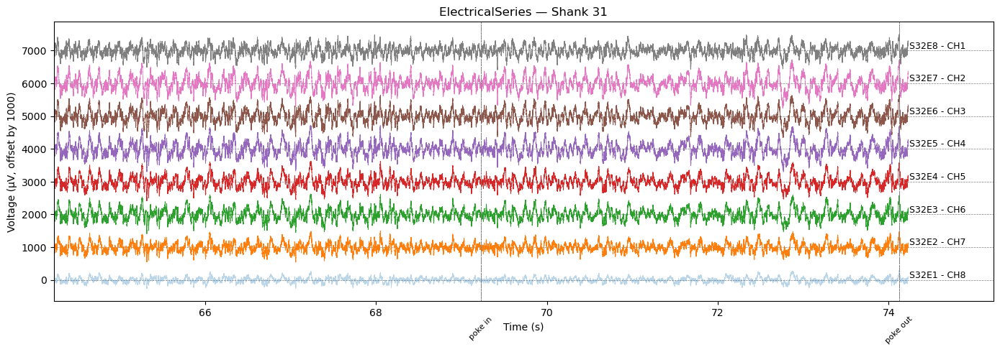

In [94]:
from spyglass_hexmaze.hex_maze_behavior import HexMazeBlock, HexPath

# Plot around nosepoke times
all_pokes = (HexMazeBlock.Trial & {"nwb_file_name": nwb_file_name}).fetch(
    "poke_interval"
)
nosepoke = all_pokes[1]
print(nosepoke)

shift = 0

# Define time window
start_time = nosepoke[0] - 5 + shift
duration = 10

# Get RAW ElectricalSeries from this nwb
e_series = nwbf.acquisition.get("ElectricalSeries")
timestamps = e_series.timestamps
n_timestamps = len(timestamps)


# Helper to find the first index >= target_time using binary search (because we have non-uniform timestamps)
def find_index(target_time, left=0, right=n_timestamps - 1):
    while left < right:
        mid = (left + right) // 2
        mid_val = timestamps[mid]
        if mid_val < target_time:
            left = mid + 1
        else:
            right = mid
    return left


# Find start and end indices using binary search (without loading all)
start_idx = find_index(start_time)
end_idx = find_index(start_time + duration)


def safe_index(vector_data, indices):
    """Helper to index NWB VectorData columns (works around HDF5 ordering limits)"""
    indices = np.asarray(indices)
    order = np.argsort(indices)
    sorted_vals = np.array(vector_data[indices[order]])
    return sorted_vals[np.argsort(order)]


t = timestamps[start_idx:end_idx]
data_chunk = e_series.data[start_idx:end_idx, :]  # lazy slice, all channels
electrode_table = nwbf.electrodes
electrode_region = e_series.electrodes
electrode_ids = electrode_region.data[:]  # indices into the electrode table

shanks = safe_index(electrode_table["probe_shank"], electrode_ids)
electrodes = safe_index(electrode_table["probe_electrode"], electrode_ids)
electrode_names = safe_index(electrode_table["electrode_name"], electrode_ids)
open_ephys_names = safe_index(electrode_table["open_ephys_channel_str"], electrode_ids)
bad_channels = safe_index(electrode_table["bad_channel"], electrode_ids)

offset = 1000
unique_shanks = np.unique(shanks)
for shank in unique_shanks:
    # Select and sort electrodes within this shank
    shank_mask = shanks == shank
    sort_idx = np.argsort(electrodes[shank_mask])
    # Apply mask and sort
    data_shank = data_chunk[:, shank_mask][:, sort_idx]
    names_shank = electrode_names[shank_mask][sort_idx]
    chan_shank = open_ephys_names[shank_mask][sort_idx]
    bad_shank = bad_channels[shank_mask][sort_idx]
    plt.figure(figsize=(14, 5))
    for i in range(data_shank.shape[1]):
        y = data_shank[:, i] + i * offset
        plt.axhline(i * offset, color="gray", linestyle="--", lw=0.5)
        alpha = 0.3 if bad_shank[i] else 1.0
        plt.plot(t, y, lw=0.6, alpha=alpha)
        label = f"{names_shank[i]} - {chan_shank[i]}"
        plt.text(
            t[-1] + 0.001 * (t[-1] - t[0]), i * offset, label, va="bottom", fontsize=9
        )

        # Add labels poke_in and poke_out
        plt.axvline(nosepoke[0] + shift, color="gray", linestyle="--", lw=0.5)
        plt.axvline(nosepoke[1] + shift, color="gray", linestyle="--", lw=0.5)

        if i == data_shank.shape[1] - 1:
            ymin, ymax = plt.ylim()
            plt.text(
                nosepoke[0] + shift,
                ymin - 0.05 * (ymax - ymin),
                "poke in",
                rotation=45,
                va="top",
                ha="center",
                fontsize=8,
            )
            plt.text(
                nosepoke[1] + shift,
                ymin - 0.05 * (ymax - ymin),
                "poke out",
                rotation=45,
                va="top",
                ha="center",
                fontsize=8,
            )
    plt.xlabel("Time (s)")
    plt.ylabel("Voltage (µV, offset by 1000)")
    plt.title(f"{e_series.name} — Shank {shank}")
    plt.xlim(t[0], t[0] + duration * 1.1)
    plt.tight_layout()
    plt.show()

## Create Filters


Next, we create the standard LFP Filters. This only needs to be done once.


In [4]:
sgc.FirFilterParameters().create_standard_filters()

standard_filter = sgc.FirFilterParameters() & {
    "filter_name": "LFP 0-400 Hz",
    "filter_sampling_rate": 30_000,
}
display(standard_filter)

band_edges = standard_filter.fetch1("filter_band_edges")
print(band_edges)
filter_coeff = standard_filter.fetch1("filter_coeff")
print(filter_coeff)

sgc.FirFilterParameters().add_filter(
    filter_name="IM-1478 LFP 0-400 Hz",
    fs=29998,
    filter_type="lowpass",
    band_edges=band_edges,
    comments="standard LFP filter adapted for 29998 Hz",
)

display(sgc.FirFilterParameters() & {"filter_name": "IM-1478 LFP 0-400 Hz"})
# sgc.FirFilterParameters() & 'filter_name LIKE "%LFP 0-400 Hz%"'

filter_name descriptive name of this filter,filter_sampling_rate sampling rate for this filter,filter_type,filter_low_stop lowest frequency for stop band for low frequency side of filter,filter_low_pass lowest frequency for pass band of low frequency side of filter,filter_high_pass highest frequency for pass band for high frequency side of filter,filter_high_stop highest frequency for stop band of high frequency side of filter,filter_comments comments about the filter,filter_band_edges numpy array containing the filter bands (redundant with individual parameters),filter_coeff numpy array containing the filter coefficients
LFP 0-400 Hz,30000,lowpass,0.0,0.0,400.0,425.0,standard LFP filter for 20 KHz data,=BLOB=,=BLOB=


[400 425]
[ 7.50241989e-20 -3.66670658e-07 -7.30182292e-07 ... -7.30182292e-07
 -3.66670658e-07  7.50241989e-20]


filter_name descriptive name of this filter,filter_sampling_rate sampling rate for this filter,filter_type,filter_low_stop lowest frequency for stop band for low frequency side of filter,filter_low_pass lowest frequency for pass band of low frequency side of filter,filter_high_pass highest frequency for pass band for high frequency side of filter,filter_high_stop highest frequency for stop band of high frequency side of filter,filter_comments comments about the filter,filter_band_edges numpy array containing the filter bands (redundant with individual parameters),filter_coeff numpy array containing the filter coefficients
IM-1478 LFP 0-400 Hz,29998,lowpass,0.0,0.0,400.0,425.0,standard LFP filter adapted for 29998 Hz,=BLOB=,=BLOB=


## Electrode Group


Now, we create an LFP electrode group, or the set of electrodes we want to
filter for LFP data. We can grab all electrodes and brain regions as a data
frame.

NOTE I label everything as CA1 in our conversion (I'm aspirational like that) so filtering by region name is useless.

In [5]:
# electrodes_df = (
#     pd.DataFrame(
#         (sgc.Electrode & {"nwb_file_name": nwb_file_name})
#         * sgc.BrainRegion
#     )
#     .loc[:, ["nwb_file_name", "electrode_id", "region_name"]]
#     .sort_values(by="electrode_id")
# )
# display(electrodes_df)

# I know that for this nwb, I want to use all electrodes that are part of my sort groups (this excludes bad channels)
electrodes_df = pd.DataFrame(
    (
        sgs.SortGroup * sgs.SortGroup.SortGroupElectrode
        & {"nwb_file_name": nwb_file_name}
    ).fetch(as_dict=True)
)
electrodes_df = electrodes_df[electrodes_df["sort_group_id"] < 32]
display(electrodes_df)

electrode_ids = electrodes_df["electrode_id"].unique().tolist()
print(electrode_ids)

,nwb_file_name,sort_group_id,electrode_group_name,electrode_id,sort_reference_electrode_id
0,IM-1478_20220726_.nwb,0,7,57,-1
1,IM-1478_20220726_.nwb,0,7,58,-1
2,IM-1478_20220726_.nwb,0,7,59,-1
3,IM-1478_20220726_.nwb,0,7,60,-1
4,IM-1478_20220726_.nwb,0,7,62,-1
...,...,...,...,...,...
166,IM-1478_20220726_.nwb,24,31,251,-1
167,IM-1478_20220726_.nwb,24,31,252,-1
168,IM-1478_20220726_.nwb,24,31,253,-1
169,IM-1478_20220726_.nwb,24,31,254,-1


[57, 58, 59, 60, 62, 63, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 98, 99, 100, 101, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 125, 126, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 171, 172, 173, 174, 175, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 225, 227, 234, 235, 240, 241, 242, 243, 244, 245, 246, 247, 249, 250, 251, 252, 253, 254, 255]


In [6]:
lfp_electrode_ids = electrode_ids
lfp_electrode_group_name = "steph_lfp_test"
lfp_eg_key = {
    "nwb_file_name": nwb_file_name,
    "lfp_electrode_group_name": lfp_electrode_group_name,
}

lfp.lfp_electrode.LFPElectrodeGroup.create_lfp_electrode_group(
    nwb_file_name=nwb_file_name,
    group_name=lfp_electrode_group_name,
    electrode_list=lfp_electrode_ids,
    skip_duplicates=True,
)

display(
    lfp.lfp_electrode.LFPElectrodeGroup.LFPElectrode()
    & {"nwb_file_name": nwb_file_name}
)

[00:28:00][INFO] Spyglass: Successfully created/updated LFPElectrodeGroup IM-1478_20220726_.nwb, steph_lfp_test with 171 electrodes.


nwb_file_name name of the NWB file,lfp_electrode_group_name the name of this group of electrodes,electrode_group_name electrode group name from NWBFile,electrode_id the unique number for this electrode
IM-1478_20220726_.nwb,steph_lfp_test,10,80
IM-1478_20220726_.nwb,steph_lfp_test,10,81
IM-1478_20220726_.nwb,steph_lfp_test,10,82
IM-1478_20220726_.nwb,steph_lfp_test,10,83
IM-1478_20220726_.nwb,steph_lfp_test,10,84
IM-1478_20220726_.nwb,steph_lfp_test,10,85
IM-1478_20220726_.nwb,steph_lfp_test,10,86
IM-1478_20220726_.nwb,steph_lfp_test,10,87
IM-1478_20220726_.nwb,steph_lfp_test,11,88
IM-1478_20220726_.nwb,steph_lfp_test,11,89


## `LFPSelection`


LFPSelection combines the data, interval and filter


In [7]:
import copy

interval_list_name = "00_r1"  # same for all Berke nwbs

lfp_s_key = copy.deepcopy(lfp_eg_key)

lfp_s_key.update(
    {
        "target_interval_list_name": interval_list_name,
        "filter_name": "IM-1478 LFP 0-400 Hz",
        "filter_sampling_rate": 29998,  # sampling rate of the data (Hz)
        "target_sampling_rate": 1_000,  # smpling rate of the lfp output (Hz)
    }
)

lfp.v1.LFPSelection.insert1(lfp_s_key, skip_duplicates=True)

display(lfp.v1.LFPSelection() & lfp_s_key)

nwb_file_name name of the NWB file,lfp_electrode_group_name the name of this group of electrodes,target_interval_list_name descriptive name of this interval list,filter_name descriptive name of this filter,filter_sampling_rate sampling rate for this filter,"target_sampling_rate the desired output sampling rate, in HZ"
IM-1478_20220726_.nwb,steph_lfp_test,00_r1,IM-1478 LFP 0-400 Hz,29998,1000.0


## Populate LFP


`LFPV1` has a similar `populate` command as we've seen before.

_Notes:_

- For full recordings, this takes ~2h when done locally, for all electrodes
- This `populate` also inserts into the LFP _Merge Table_, `LFPOutput`. For more
  on Merge Tables, see our documentation. In short, this collects different LFP
  processing streams into one table.


In [8]:
lfp.v1.LFPV1().populate(lfp_s_key)

{'success_count': 0, 'error_list': []}

We can now look at the LFP table to see the data we've extracted


In [9]:
display(lfp.LFPOutput.LFPV1() & lfp_s_key)

lfp_key = {"merge_id": (lfp.LFPOutput.LFPV1() & lfp_s_key).fetch1("merge_id")}
print(lfp_key)

display(lfp.LFPOutput & lfp_key)

lfp_df = (lfp.LFPOutput & lfp_key).fetch1_dataframe()
display(lfp_df)

merge_id,nwb_file_name name of the NWB file,lfp_electrode_group_name the name of this group of electrodes,target_interval_list_name descriptive name of this interval list,filter_name descriptive name of this filter,filter_sampling_rate sampling rate for this filter
38e1e4cd-7a10-6860-86f2-7426426ab02d,IM-1478_20220726_.nwb,steph_lfp_test,00_r1,IM-1478 LFP 0-400 Hz,29998


{'merge_id': UUID('38e1e4cd-7a10-6860-86f2-7426426ab02d')}


merge_id,source
38e1e4cd-7a10-6860-86f2-7426426ab02d,LFPV1


[2025-12-02 00:28:10,085][WARNING]: Skipped checksum for file with hash: b9bd8ec4-1ff0-ff8e-fd88-9ca6b9829aa5, and path: /stelmo/nwb/analysis/IM-1478_20220726/IM-1478_20220726_WCCI3KXMUQ.nwb
[2025-12-02 00:28:10,094][WARNING]: Skipped checksum for file with hash: b9bd8ec4-1ff0-ff8e-fd88-9ca6b9829aa5, and path: /stelmo/nwb/analysis/IM-1478_20220726/IM-1478_20220726_WCCI3KXMUQ.nwb
[2025-12-02 00:28:10,100][WARNING]: Skipped checksum for file with hash: b9bd8ec4-1ff0-ff8e-fd88-9ca6b9829aa5, and path: /stelmo/nwb/analysis/IM-1478_20220726/IM-1478_20220726_WCCI3KXMUQ.nwb


,0,1,2,3,4,5,6,7,8,9,...,161,162,163,164,165,166,167,168,169,170
time,,,,,,,,,,,,,,,,,,,,,
49.923318,-38,-40,-37,-37,-41,-37,-54,-55,-43,-39,...,-132,-123,-111,-127,-130,-128,-122,-110,-96,-76
49.924285,-78,-68,-57,-57,-63,-71,-102,-90,-60,-63,...,-266,-259,-226,-242,-270,-265,-255,-229,-183,-132
49.925251,-46,-34,-22,-12,-15,-15,-49,-25,-16,-14,...,-233,-223,-189,-220,-239,-235,-219,-193,-140,-95
49.926218,-2,7,7,21,25,40,10,22,25,21,...,-238,-211,-169,-215,-227,-224,-200,-163,-133,-96
49.927185,45,52,62,64,89,93,53,59,50,44,...,-237,-216,-178,-196,-213,-213,-194,-148,-133,-108
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4373.820300,-111,-114,-99,-100,-112,-80,-142,-115,-111,-95,...,-110,-92,-60,-111,-112,-117,-90,-40,13,-3
4373.821267,-85,-80,-79,-80,-70,-55,-117,-94,-86,-52,...,-102,-71,-37,-101,-100,-110,-69,-18,33,15
4373.822233,-66,-62,-60,-67,-47,-39,-83,-64,-55,-26,...,-66,-35,-4,-76,-66,-74,-40,2,56,35


## LFP Band

Now that we've created the LFP object we can perform a second level of filtering for a band of interest, in this case the theta band. We first need to create the filter.


In [10]:
lfp_sampling_rate = lfp.LFPOutput.merge_get_parent(lfp_key).fetch1("lfp_sampling_rate")

filter_name = "Theta 5-11 Hz"

sgc.common_filter.FirFilterParameters().add_filter(
    filter_name,
    lfp_sampling_rate,
    "bandpass",
    [4, 5, 11, 12],
    "theta filter for 1 Khz data",
)

sgc.common_filter.FirFilterParameters() & {
    "filter_name": filter_name,
    "filter_sampling_rate": lfp_sampling_rate,
}

filter_name descriptive name of this filter,filter_sampling_rate sampling rate for this filter,filter_type,filter_low_stop lowest frequency for stop band for low frequency side of filter,filter_low_pass lowest frequency for pass band of low frequency side of filter,filter_high_pass highest frequency for pass band for high frequency side of filter,filter_high_stop highest frequency for stop band of high frequency side of filter,filter_comments comments about the filter,filter_band_edges numpy array containing the filter bands (redundant with individual parameters),filter_coeff numpy array containing the filter coefficients
Theta 5-11 Hz,1034,bandpass,4.0,5.0,11.0,12.0,theta filter for 1 Khz data,=BLOB=,=BLOB=


We can specify electrodes of interest, and desired sampling rate.


In [11]:
from spyglass.lfp.analysis.v1 import lfp_band

lfp_band_electrode_ids = lfp_electrode_ids  # assumes we've filtered these electrodes
lfp_band_sampling_rate = 103  # desired sampling rate

lfp_band.LFPBandSelection().set_lfp_band_electrodes(
    nwb_file_name=nwb_file_name,
    lfp_merge_id=lfp_key["merge_id"],
    electrode_list=lfp_band_electrode_ids,
    filter_name=filter_name,  # defined above
    interval_list_name=interval_list_name,  # Defined in IntervalList above
    reference_electrode_list=[-1],  # -1 means no ref electrode for all channels
    lfp_band_sampling_rate=lfp_band_sampling_rate,
)

lfp_band.LFPBandSelection() & {"nwb_file_name": nwb_file_name}

[00:28:34][INFO] Spyglass: It is recommended to use the same sampling rate as the original lfp data to avoid aliasing.
[00:28:34][INFO] Spyglass: LFPBandSelection already exists for {'nwb_file_name': 'IM-1478_20220726_.nwb', 'lfp_merge_id': UUID('38e1e4cd-7a10-6860-86f2-7426426ab02d'), 'filter_name': 'Theta 5-11 Hz', 'filter_sampling_rate': 1034.0, 'target_interval_list_name': '00_r1', 'lfp_band_sampling_rate': 103.0}; not inserting


lfp_merge_id,filter_name descriptive name of this filter,filter_sampling_rate sampling rate for this filter,nwb_file_name name of the NWB file,target_interval_list_name descriptive name of this interval list,lfp_band_sampling_rate the sampling rate for this band,min_interval_len the minimum length of a valid interval to filter
38e1e4cd-7a10-6860-86f2-7426426ab02d,Theta 5-11 Hz,1034,IM-1478_20220726_.nwb,00_r1,103,1.0


Next we add an entry for the LFP Band and the electrodes we want to filter


In [12]:
lfp_band_key = (
    lfp_band.LFPBandSelection
    & {
        "lfp_merge_id": lfp_key["merge_id"],
        "filter_name": filter_name,
        "lfp_band_sampling_rate": lfp_band_sampling_rate,
    }
).fetch1("KEY")

display(lfp_band.LFPBandSelection() & lfp_band_key)

lfp_merge_id,filter_name descriptive name of this filter,filter_sampling_rate sampling rate for this filter,nwb_file_name name of the NWB file,target_interval_list_name descriptive name of this interval list,lfp_band_sampling_rate the sampling rate for this band,min_interval_len the minimum length of a valid interval to filter
38e1e4cd-7a10-6860-86f2-7426426ab02d,Theta 5-11 Hz,1034,IM-1478_20220726_.nwb,00_r1,103,1.0


In [13]:
lfp_band.LFPBandV1().populate(lfp_band.LFPBandSelection() & lfp_band_key)
lfp_band.LFPBandV1() & lfp_band_key

lfp_merge_id,filter_name descriptive name of this filter,filter_sampling_rate sampling rate for this filter,nwb_file_name name of the NWB file,target_interval_list_name descriptive name of this interval list,lfp_band_sampling_rate the sampling rate for this band,analysis_file_name name of the file,interval_list_name descriptive name of this interval list,lfp_band_object_id the NWB object ID for loading this object from the file
38e1e4cd-7a10-6860-86f2-7426426ab02d,Theta 5-11 Hz,1034,IM-1478_20220726_.nwb,00_r1,103,IM-1478_20220726_P1IF1KLOHC.nwb,00_r1 lfp band 103Hz,8be31701-7249-4d6b-b0b5-e3c413eca64f


## Compute theta analytic signal, phase, and power

In [43]:
theta_analytic_signal = (lfp_band.LFPBandV1() & lfp_band_key).compute_analytic_signal(
    electrode_list=lfp_band_electrode_ids
)
theta_phase = (lfp_band.LFPBandV1() & lfp_band_key).compute_signal_phase(
    electrode_list=lfp_band_electrode_ids
)
theta_power = (lfp_band.LFPBandV1() & lfp_band_key).compute_signal_power(
    electrode_list=lfp_band_electrode_ids
)

display(theta_analytic_signal)
display(theta_phase)
display(theta_power)

,electrode 57,electrode 58,electrode 59,electrode 60,electrode 62,electrode 63,electrode 65,electrode 66,electrode 67,electrode 68,...,electrode 245,electrode 246,electrode 247,electrode 249,electrode 250,electrode 251,electrode 252,electrode 253,electrode 254,electrode 255
time,,,,,,,,,,,,,,,,,,,,,
49.923318,-26.000000+ 27.069684j,-25.000000+ 33.814070j,-19.000000+ 36.800565j,-16.000000+ 42.450583j,-10.000000+ 48.410590j,-4.000000+ 50.449602j,-30.000000+ 19.355451j,-25.000000+ 23.057629j,-20.000000+ 34.826499j,-18.000000+ 40.666809j,...,2.000000- 55.283603j,13.000000- 57.099286j,40.000000- 27.085489j,-18.000000- 28.199565j,-10.000000- 43.254006j,-12.000000- 45.310654j,18.000000- 51.665540j,56.000000- 19.364135j,71.000000- 34.592796j,68.000000+ 32.981215j
49.932985,-67.000000+ 60.558227j,-70.000000+ 69.077359j,-68.000000+ 80.019197j,-69.000000+ 88.165993j,-72.000000+109.388164j,-68.000000+116.206687j,-69.000000+ 49.862850j,-66.000000+ 57.916027j,-65.000000+ 70.531731j,-67.000000+ 78.488862j,...,79.000000-122.347512j,94.000000-126.418202j,103.000000- 77.319003j,28.000000- 83.713768j,56.000000-113.673254j,56.000000-116.344255j,96.000000-116.448630j,119.000000- 66.993378j,144.000000- 77.831567j,97.000000+ 5.882366j
49.942652,-100.000000+ 17.248295j,-107.000000+ 24.949139j,-111.000000+ 35.441724j,-116.000000+ 42.830528j,-131.000000+ 60.119952j,-131.000000+ 67.951629j,-98.000000+ 7.679602j,-99.000000+ 15.636826j,-103.000000+ 28.565447j,-109.000000+ 35.043527j,...,148.000000- 60.278379j,166.000000- 55.812431j,150.000000- 5.492120j,77.000000- 54.546367j,122.000000- 65.935952j,122.000000- 68.070037j,163.000000- 46.403228j,160.000000+ 14.444719j,190.000000+ 17.313850j,103.000000+ 66.445227j
49.952320,-113.000000- 21.429159j,-124.000000- 16.740224j,-134.000000- 7.210189j,-143.000000- 2.073928j,-168.000000+ 10.259674j,-172.000000+ 17.597385j,-108.000000- 30.453480j,-112.000000- 22.677664j,-122.000000- 12.201465j,-131.000000- 8.412956j,...,186.000000+ 4.968741j,202.000000+ 16.882333j,159.000000+ 58.325848j,110.000000- 21.452256j,163.000000- 12.979791j,165.000000- 16.095872j,195.000000+ 24.675126j,160.000000+ 80.809761j,188.000000+ 98.972806j,77.000000+105.052001j
49.961987,-99.000000- 81.955151j,-112.000000- 82.171984j,-126.000000- 78.809188j,-138.000000- 78.762051j,-169.000000- 80.239222j,-176.000000- 76.366472j,-90.000000- 88.190457j,-98.000000- 82.753827j,-112.000000- 77.581208j,-123.000000- 77.854307j,...,174.000000+113.059174j,183.000000+132.986736j,122.000000+147.796794j,116.000000+ 45.155193j,162.000000+ 82.687094j,165.000000+ 82.060168j,173.000000+137.054636j,111.000000+172.617913j,128.000000+204.097521j,22.000000+146.262066j
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4373.776800,132.000000+ 77.178460j,136.000000+ 73.672406j,141.000000+ 72.186850j,146.000000+ 67.420833j,168.000000+ 73.703804j,171.000000+ 69.116237j,110.000000+ 90.359171j,118.000000+ 83.501475j,128.000000+ 65.991799j,133.000000+ 64.051631j,...,-185.000000- 48.097082j,-212.000000- 62.985280j,-189.000000-116.004913j,-100.000000- 20.788471j,-153.000000- 40.551740j,-154.000000- 37.225727j,-198.000000- 78.589076j,-206.000000-148.196076j,-244.000000-149.955968j,-116.000000-201.693417j
4373.786467,72.000000+127.233501j,77.000000+127.821638j,82.000000+128.990853j,88.000000+127.881868j,104.000000+144.551993j,108.000000+141.770356j,48.000000+129.384629j,58.000000+126.681517j,74.000000+116.840033j,79.000000+117.402386j,...,-124.000000-133.852855j,-138.000000-159.442962j,-96.000000-190.025234j,-69.000000- 69.301192j,-103.000000-112.307711j,-105.000000-110.753043j,-121.000000-165.359644j,-96.000000-223.566398j,-124.000000-243.609564j,0.000000-224.113740j
4373.796133,4.000000+125.664872j,8.000000+127.840638j,12.000000+129.920988j,18.000000+131.075787j,24.000000+149.386320j,29.000000+148.316618j,-15.000000+118.295554j,-6.000000+119.445586j,11.000000+117.881086j,15.000000+119.999721j,...,-41.000000-148.465251j,-40.000000-174.429863j,7.0

,electrode 57,electrode 58,electrode 59,electrode 60,electrode 62,electrode 63,electrode 65,electrode 66,electrode 67,electrode 68,...,electrode 245,electrode 246,electrode 247,electrode 249,electrode 250,electrode 251,electrode 252,electrode 253,electrode 254,electrode 255
time,,,,,,,,,,,,,,,,,,,,,
49.923318,5.477634,5.349031,5.188989,5.072832,4.916090,4.791511,5.710205,5.538183,5.233678,5.129090,...,1.606958,1.794654,2.546376,1.002685,1.343596,1.311902,1.906040,2.808675,2.688219,3.593183
49.932985,5.548245,5.504421,5.416765,5.376439,5.294512,5.241828,5.657419,5.562932,5.456995,5.418983,...,2.144144,2.210166,2.497663,1.893572,2.028539,2.019397,2.260238,2.628847,2.646075,3.202161
49.942652,6.112383,6.054109,5.974122,5.929484,5.852929,5.804678,6.204982,6.126532,6.012650,5.972122,...,2.754821,2.817247,3.104995,2.525255,2.646104,2.632665,2.864247,3.231628,3.232467,3.714515
49.952320,0.187413,0.134191,0.053756,0.014502,6.222192,6.181230,0.274841,0.199778,0.099681,0.064133,...,3.168300,3.224975,3.493181,2.948990,3.062130,3.044350,3.267463,3.609281,3.626177,4.079876
49.961987,0.691481,0.632973,0.558937,0.518627,0.443276,0.409385,0.775243,0.701250,0.605803,0.564304,...,3.717803,3.770017,4.022317,3.512814,3.613537,3.603105,3.811574,4.140923,4.152244,4.563093
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4373.776800,3.670675,3.638048,3.614765,3.574205,3.555021,3.525705,3.829275,3.757427,3.617611,3.590405,...,0.254353,0.288794,0.550492,0.204965,0.259087,0.237176,0.377844,0.623627,0.551067,1.048864
4373.786467,4.197429,4.170205,4.146129,4.109671,4.088719,4.061381,4.357141,4.283034,4.147812,4.120084,...,0.823591,0.857365,1.103001,0.787576,0.828601,0.812057,0.939085,1.165203,1.099966,1.570796
4373.796133,4.680569,4.649893,4.620286,4.575917,4.553093,4.519297,4.838517,4.762579,4.619344,4.588034,...,1.301353,1.345375,1.609225,1.253520,1.301787,1.283684,1.426361,1.675695,1.604660,2.099656


,electrode 57,electrode 58,electrode 59,electrode 60,electrode 62,electrode 63,electrode 65,electrode 66,electrode 67,electrode 68,...,electrode 245,electrode 246,electrode 247,electrode 249,electrode 250,electrode 251,electrode 252,electrode 253,electrode 254,electrode 255
time,,,,,,,,,,,,,,,,,,,,,
49.923318,1408.767818,1768.391362,1715.281592,2058.051977,2443.585264,2561.162305,1274.633481,1156.654270,1612.885035,1977.789375,...,3060.276720,3429.328414,2333.623715,1119.215460,1970.909013,2197.055409,2993.328053,3510.969718,6237.661567,5711.760513
49.932985,8156.298896,9671.681584,11027.071920,12534.242361,17149.770518,18127.994150,7247.303784,7710.266155,9199.725136,10649.501527,...,21209.913748,24817.561915,16587.228293,7791.995010,16057.608644,16671.985759,22776.283442,18649.112653,26793.752786,9443.602231
49.942652,10297.503666,12071.459535,13577.115788,15290.454167,20775.408661,21778.423861,9662.976289,10045.510335,11424.984742,13109.048792,...,25537.482944,30671.027421,22530.163379,8904.306149,19231.549814,19517.529896,28722.259594,25808.649911,36399.769394,15023.968128
49.952320,13228.208852,15656.235113,18007.986818,20453.301179,28329.260909,29893.667951,12591.414462,13058.276426,15032.875745,17231.777826,...,34620.688389,41089.013169,28682.904601,12560.199307,26737.474975,27484.077101,38633.861822,32130.217420,45139.616287,16964.922956
49.961987,16517.646750,19296.234941,22086.888038,25247.460689,34999.332671,36807.837980,15877.556705,16452.195934,18562.843759,21190.293075,...,43058.376920,51174.471839,36727.892364,15494.991453,33081.155573,33958.871154,48712.973133,42117.943805,58039.798047,21876.591940
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4373.776800,23380.514667,23923.623446,25091.941251,25861.568775,33656.250712,34018.054266,20264.779699,20896.496363,20738.917513,21791.611463,...,36538.329279,48911.145521,49178.139736,10432.160539,25053.443611,25101.754782,45380.242944,64398.076806,82022.792251,54136.234659
4373.786467,21372.363878,22267.371232,23362.640185,24097.772098,31711.278765,31762.833915,19044.382118,19412.206839,19127.593289,20024.320193,...,33292.586810,44466.058100,45325.589565,9563.655159,23222.022027,23291.236592,41984.811954,59197.934451,74721.619444,50226.968610
4373.796133,15807.660139,16407.228820,17023.463014,17504.861972,22892.272483,22838.819144,14218.838006,14303.247923,14016.950454,14624.933029,...,23722.930662,32025.777010,33196.259122,6421.337792,16365.359077,16160.959917,30168.657109,44147.158976,55830.515673,39281.968059


## Plotting


In [15]:
from spyglass_hexmaze.hex_maze_behavior import HexMazeBlock, HexPath, HexPosition

# Get nosepoke times
all_pokes = (HexMazeBlock.Trial & {"nwb_file_name": nwb_file_name}).fetch(
    "poke_interval"
)
nosepoke = all_pokes[5]
print(nosepoke)

plottimes = [nosepoke[0] - 2, nosepoke[0] + 1]
print(plottimes)

[174.56      189.6082304]
[172.56, 175.56]


Now we can plot the original signal, the LFP filtered trace, and the theta
filtered trace together. Get the three electrical series objects and the indices
of the electrodes we band pass filtered

_Note:_ Much of the code below could be replaced by a function calls that would
return the data from each electrical series.

_Note:_ If you see an error `Qt: Session Management Error`, try running the
following unix command: `export -n SESSION_MANAGER`.
[See also](https://stackoverflow.com/questions/986964/qt-session-management-error)


In [44]:
# Get raw eseries
orig_eseries = (sgc.Raw() & {"nwb_file_name": nwb_file_name}).fetch_nwb()[0]["raw"]
orig_elect_indices = sgc.get_electrode_indices(orig_eseries, lfp_band_electrode_ids)
orig_timestamps = np.asarray(orig_eseries.timestamps)
orig_time_ind = np.where(
    np.logical_and(orig_timestamps > plottimes[0], orig_timestamps < plottimes[1])
)[0]

# Get lfp eseries
lfp_eseries = lfp.LFPOutput().fetch_nwb(lfp_key)[0]["lfp"]
lfp_elect_indices = sgc.get_electrode_indices(lfp_eseries, lfp_band_electrode_ids)
lfp_timestamps = np.asarray(lfp_eseries.timestamps)
lfp_time_ind = np.where(
    np.logical_and(lfp_timestamps > plottimes[0], lfp_timestamps < plottimes[1])
)[0]

# Get lfp band (theta) eseries
lfp_band_eseries = (lfp_band.LFPBandV1 & lfp_band_key).fetch_nwb()[0]["lfp_band"]
lfp_band_elect_indices = sgc.get_electrode_indices(
    lfp_band_eseries, lfp_band_electrode_ids
)
lfp_band_timestamps = np.asarray(lfp_band_eseries.timestamps)
lfp_band_time_ind = np.where(
    np.logical_and(
        lfp_band_timestamps > plottimes[0], lfp_band_timestamps < plottimes[1]
    )
)[0]

[2025-12-02 12:53:34,773][WARNING]: Skipped checksum for file with hash: b9bd8ec4-1ff0-ff8e-fd88-9ca6b9829aa5, and path: /stelmo/nwb/analysis/IM-1478_20220726/IM-1478_20220726_WCCI3KXMUQ.nwb
[2025-12-02 12:53:34,781][WARNING]: Skipped checksum for file with hash: b9bd8ec4-1ff0-ff8e-fd88-9ca6b9829aa5, and path: /stelmo/nwb/analysis/IM-1478_20220726/IM-1478_20220726_WCCI3KXMUQ.nwb
[2025-12-02 12:53:34,787][WARNING]: Skipped checksum for file with hash: b9bd8ec4-1ff0-ff8e-fd88-9ca6b9829aa5, and path: /stelmo/nwb/analysis/IM-1478_20220726/IM-1478_20220726_WCCI3KXMUQ.nwb


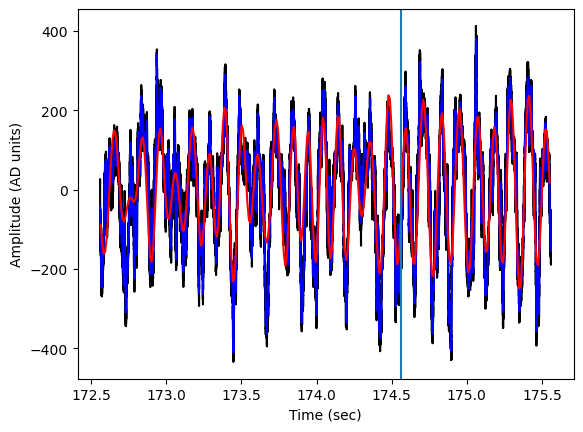

In [45]:
import matplotlib.pyplot as plt

electrode_idx = 20

plt.plot(
    orig_eseries.timestamps[orig_time_ind],
    orig_eseries.data[orig_time_ind, orig_elect_indices[electrode_idx]],
    "k-",
)
plt.plot(
    lfp_eseries.timestamps[lfp_time_ind],
    lfp_eseries.data[lfp_time_ind, lfp_elect_indices[electrode_idx]],
    "b-",
)
plt.plot(
    lfp_band_eseries.timestamps[lfp_band_time_ind],
    lfp_band_eseries.data[lfp_band_time_ind, lfp_band_elect_indices[electrode_idx]],
    "r-",
)
plt.axvline(nosepoke[0])
plt.xlabel("Time (sec)")
plt.ylabel("Amplitude (AD units)")
plt.show()

In [62]:
from spyglass_hexmaze.hex_maze_behavior import HexPosition

# Get position
pos_key = (HexPosition() & {"nwb_file_name": nwb_file_name}).fetch("KEY")[0]
pos_df = (HexPosition() & pos_key).fetch_hex_and_position_dataframe()

In [19]:
# Get one electrode per group
one_electrode_per_group = electrodes_df.groupby("electrode_group_name")[
    "electrode_id"
].first()
one_electrode_per_group.values

array([ 80,  88,  98, 104, 112, 120, 130, 136, 145, 152, 160, 168, 177,
       184, 192, 200, 208, 216, 225, 234, 240, 249,  57,  65,  72])

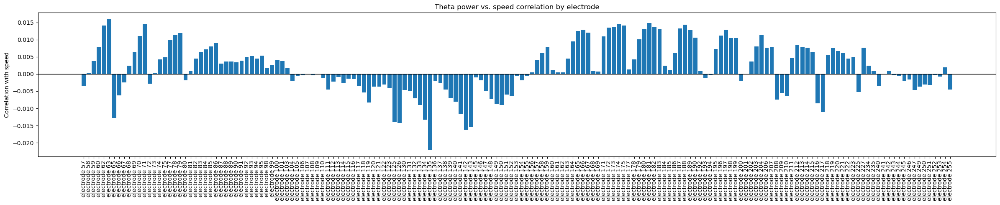

In [ ]:
# Do speed vs theta correlation by electrode

# Align start times
start = min(theta_power.index.min(), pos_df.index.min())
theta_binned = theta_power.copy()
speed_binned = pos_df["speed"].copy()
theta_binned.index -= start
speed_binned.index -= start

# Bin and average
bin_size = 0.2
theta_binned = theta_binned.groupby((theta_binned.index // bin_size) * bin_size).mean()
speed_binned = speed_binned.groupby((speed_binned.index // bin_size) * bin_size).mean()

# Join and correlate
df = theta_binned.join(speed_binned, how="inner")
corrs = df.corr()["speed"].drop("speed")

# Plot
plt.figure(figsize=(24, 5))
plt.bar(corrs.index, corrs.values)
plt.xticks(rotation=90)
plt.ylabel("Correlation with speed")
plt.title("Theta power vs. speed correlation by electrode")
plt.axhline(0, color="black", linewidth=1)
plt.tight_layout()
plt.show()

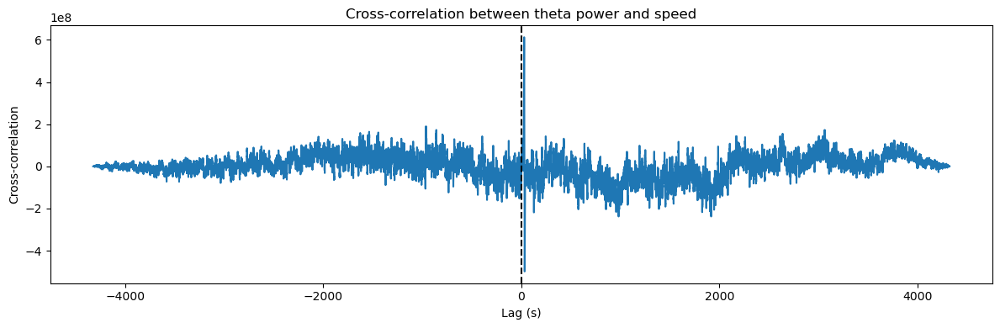

Max correlation at lag = 28.40 s, value = 612296962.02


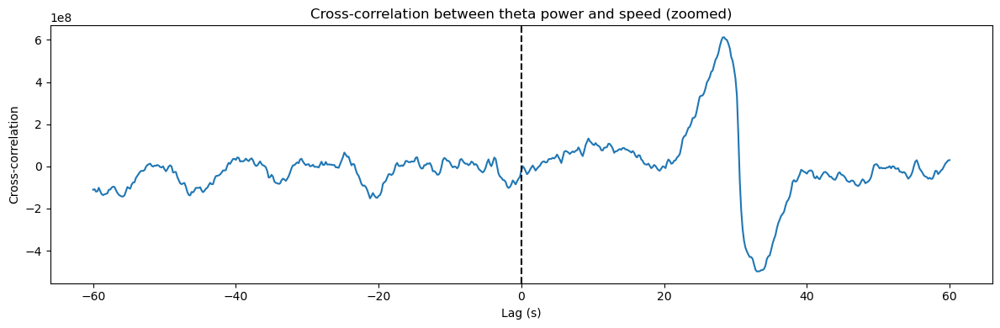

In [87]:
import numpy as np

# Convert to arrays
e_idx = 170
theta_arr = df.iloc[:, e_idx].values
speed_arr = df["speed"].values

# Compute cross-correlation
xcorr = np.correlate(
    theta_arr - theta_arr.mean(), speed_arr - speed_arr.mean(), mode="full"
)

# Get lag times in seconds
lags = np.arange(-len(theta_arr) + 1, len(theta_arr)) * bin_size

# Plot cross-correlation
plt.figure(figsize=(12, 4))
plt.plot(lags, xcorr)
plt.xlabel("Lag (s)")
plt.ylabel("Cross-correlation")
plt.title("Cross-correlation between theta power and speed")
plt.axvline(0, color="black", linestyle="--")
plt.tight_layout()
plt.show()

# Find lag of max correlation
max_idx = np.argmax(xcorr)
max_lag = lags[max_idx]
max_value = xcorr[max_idx]

print(f"Max correlation at lag = {max_lag:.2f} s, value = {max_value:.2f}")

# Now zoom in
lag_window = 60
mask = (lags >= -lag_window) & (lags <= lag_window)

# Plot zoomed cross-correlation
plt.figure(figsize=(12, 4))
plt.plot(lags[mask], xcorr[mask])
plt.xlabel("Lag (s)")
plt.ylabel("Cross-correlation")
plt.title("Cross-correlation between theta power and speed (zoomed)")
plt.axvline(0, color="black", linestyle="--")
plt.tight_layout()
plt.show()

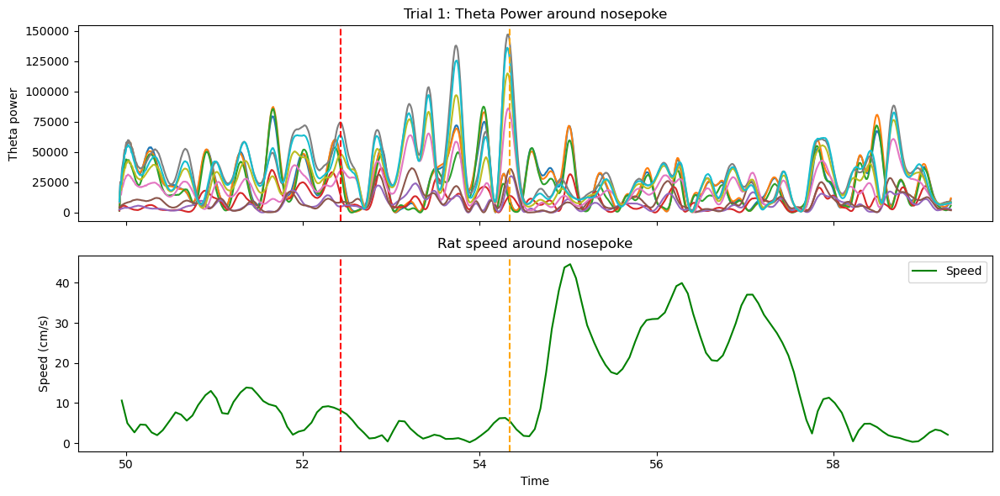

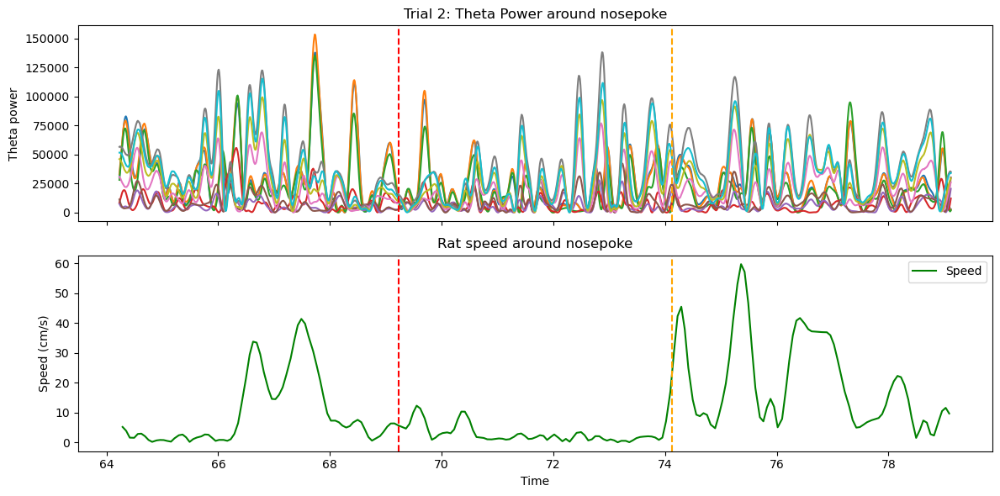

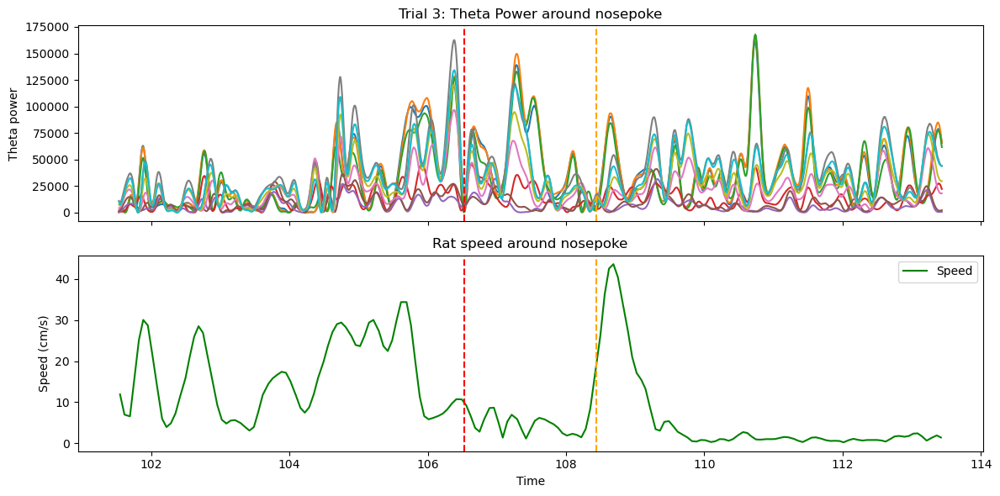

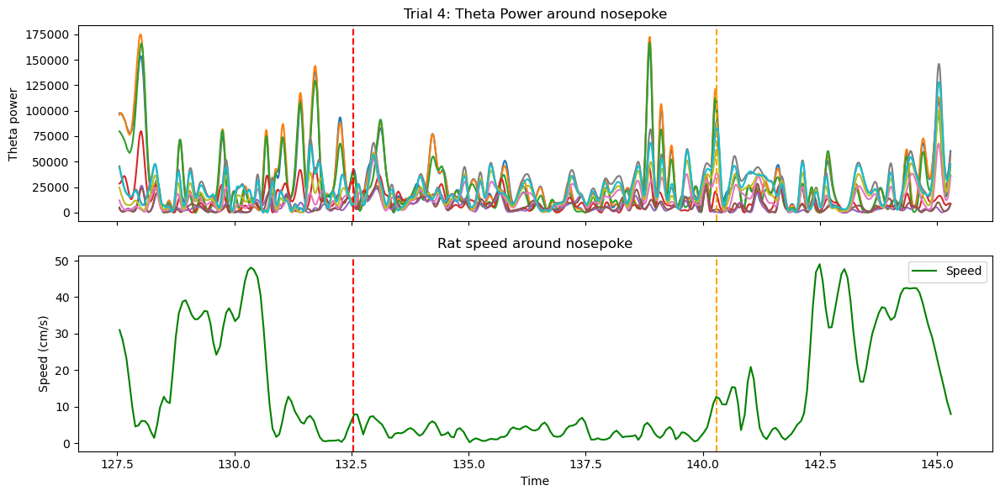

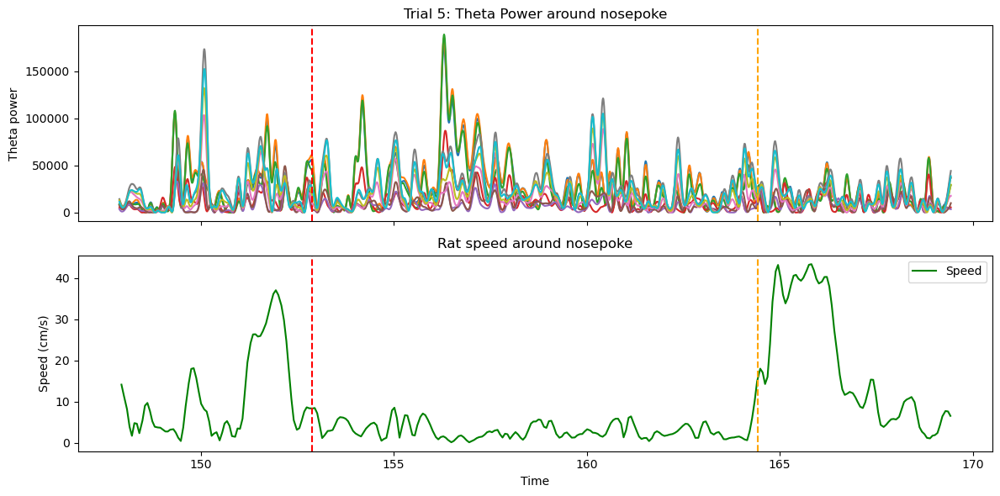

...

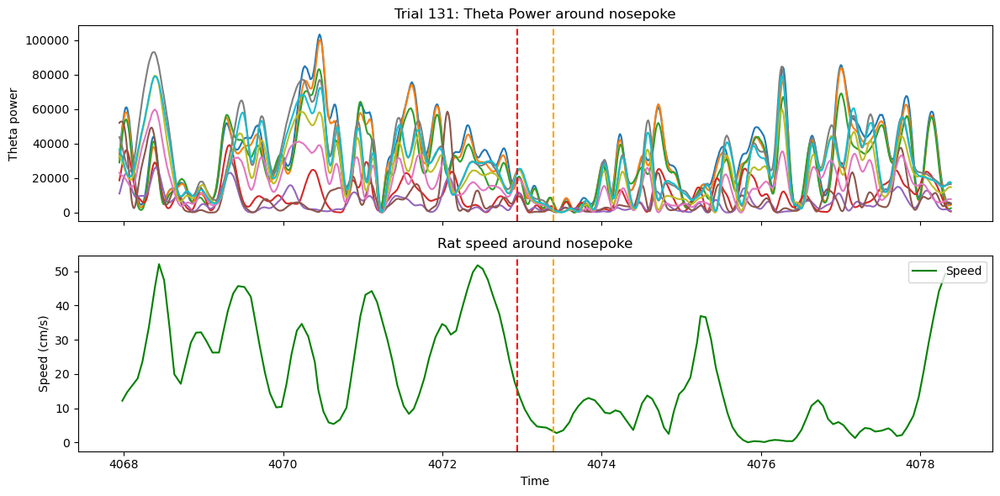

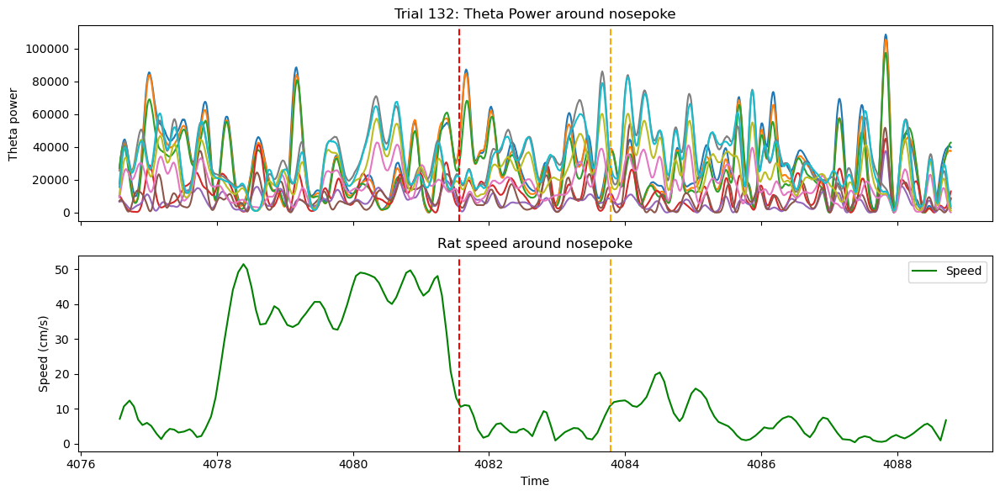

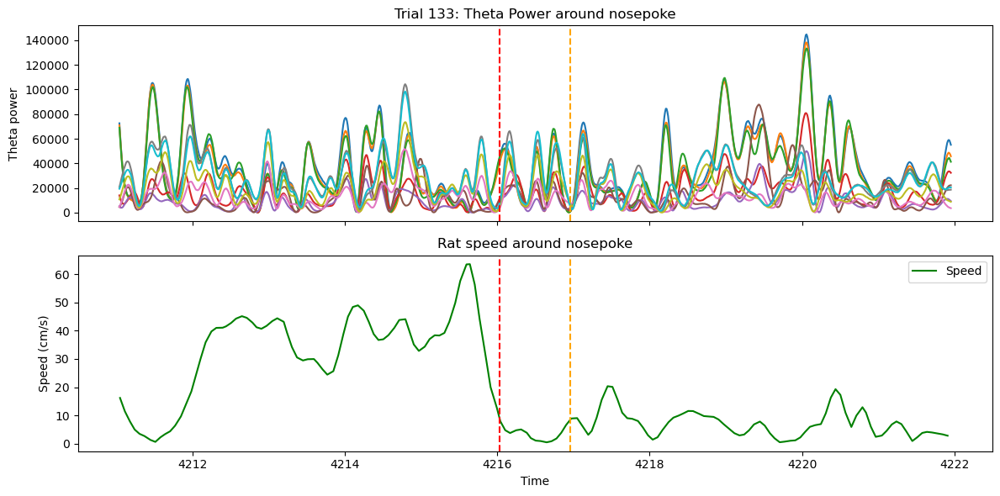

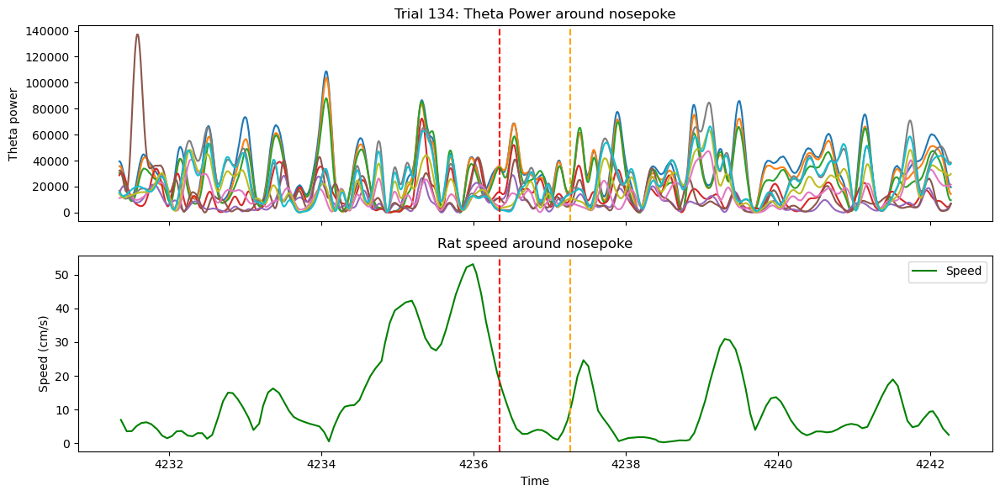

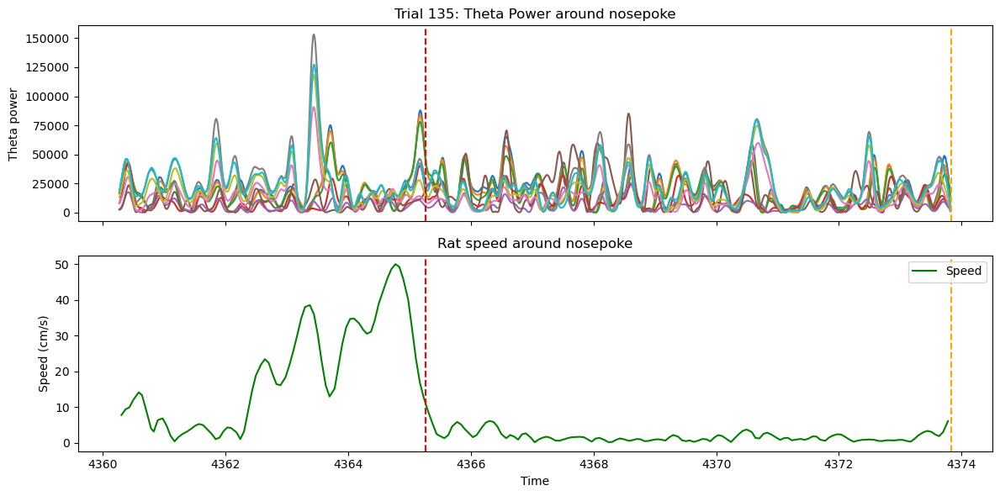

In [88]:
from spyglass_hexmaze.hex_maze_behavior import HexMazeBlock


high_corr_electrodes = [63, 71, 86, 125, 135, 142, 165, 174, 181, 189]

# Set params
electrodes = high_corr_electrodes  # one_electrode_per_group.values
window_before = 5  # seconds before poke_in
window_after = 5  # seconds after poke_out
ephys_shift = 0  # 28.6

# Get all poke intervals
all_pokes = (HexMazeBlock.Trial & {"nwb_file_name": nwb_file_name}).fetch(
    "poke_interval"
)

# Plot theta power and speed around each poke
for i, poke in enumerate(all_pokes):
    # Adjust plot window for potential ephys shift
    theta_start = poke[0] - window_before + ephys_shift
    theta_end = poke[1] + window_after + ephys_shift
    speed_start = poke[0] - window_before
    speed_end = poke[1] + window_after

    speed_subset = pos_df.loc[speed_start:speed_end, "speed"]

    fig, axes = plt.subplots(2, 1, figsize=(12, 6), sharex=True)

    # Theta power
    for elec in electrodes:
        elec_name = f"electrode {elec}"
        theta_subset = theta_power.loc[theta_start:theta_end, elec_name]

        shifted_index = theta_subset.index + ephys_shift

        axes[0].plot(
            theta_subset.index - ephys_shift, theta_subset.values, label=f"{elec_name}"
        )
    axes[0].axvline(poke[0], color="red", linestyle="--", label="poke_in")
    axes[0].axvline(poke[1], color="orange", linestyle="--", label="poke_out")
    axes[0].set_ylabel("Theta power")
    axes[0].set_title(f"Trial {i+1}: Theta Power around nosepoke")
    # axes[0].legend(loc='upper right')

    # Speed
    axes[1].plot(speed_subset.index, speed_subset.values, color="green", label="Speed")
    axes[1].axvline(poke[0], color="red", linestyle="--")
    axes[1].axvline(poke[1], color="orange", linestyle="--")
    axes[1].set_xlabel("Time")
    axes[1].set_ylabel("Speed (cm/s)")
    axes[1].set_title("Rat speed around nosepoke")
    axes[1].legend(loc="upper right")

    plt.tight_layout()
    plt.show()